## Importing Necessary Libraries

In [114]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline
import missingno as msno
import ydata_profiling as pp 

from sklearn.preprocessing import LabelEncoder, PowerTransformer, StandardScaler,  MinMaxScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import f1_score, confusion_matrix, roc_auc_score, accuracy_score

from sklearn.linear_model import RidgeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
import joblib

## Loading and Understading the Dataset

In [4]:
hotel_df = pd.read_csv("../data/hotel.csv")
hotel_df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [5]:
# Check the shape of the dataset
hotel_df.shape

(119390, 32)

In [6]:
# Summary statistics of the dataset
hotel_df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


In [7]:
# Data types and missing values
hotel_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

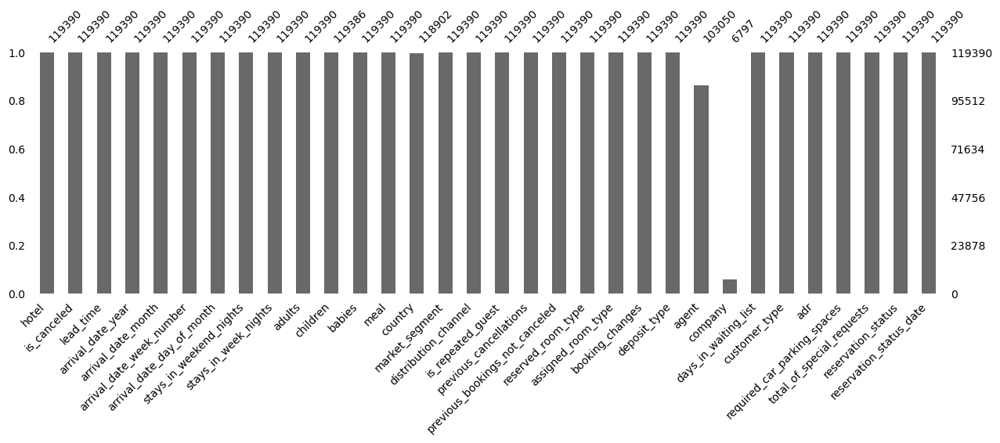

In [8]:
# Visualize missing values
msno.bar(hotel_df,  figsize=(15, 4), fontsize=10)
plt.show()

- company - The column holds 94% missing data -> drop the column

## Data Preprocessing

### Treating the missing values

In [9]:
hotel_df.drop('company',axis=1, inplace = True)
#

<Axes: >

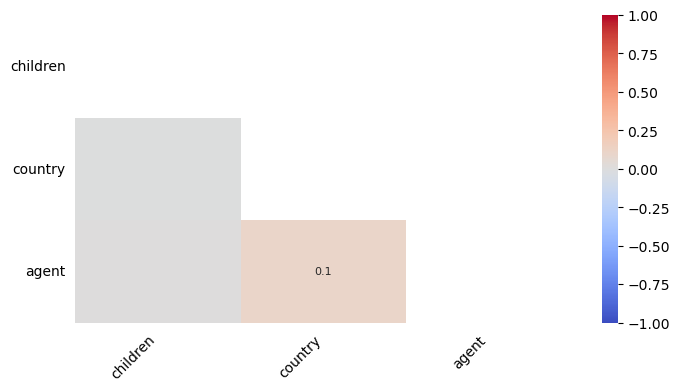

In [10]:
msno.heatmap(hotel_df, figsize=(8, 4), fontsize=10, vmin=-1, vmax=1, cmap='coolwarm')

- There is 10% relationship between the agent and the company

In [11]:
hotel_df['country'].fillna(hotel_df['country'].mode()[0], inplace=True)
hotel_df['agent'].fillna(hotel_df['agent'].mode()[0], inplace=True)

In [12]:
# Removing the rows with zero number of guests
filter = (hotel_df.children == 0) & (hotel_df.adults == 0) & (hotel_df.babies == 0)
hotel_df = hotel_df[~filter]


- Target Variable : is_canceled

### Transforming the Data

In [13]:
hotel_df['arrival_date'] = hotel_df['arrival_date_year'].astype(str)+'-'+hotel_df['arrival_date_month'].astype(str)+'-'+hotel_df['arrival_date_day_of_month'].astype(str)

In [14]:
hotel_df['children'] = hotel_df['children'].fillna(0)
hotel_df['children'] = (hotel_df['children'] + hotel_df['babies']).astype(int)

In [15]:
hotel_df['total_bookings'] = hotel_df['previous_cancellations'] + hotel_df['previous_bookings_not_canceled']

In [16]:
hotel_df['reservation_status_date'] = pd.to_datetime(hotel_df['reservation_status_date'])
hotel_df['arrival_date'] = pd.to_datetime(hotel_df['arrival_date'])

In [17]:
hotel_df['stay_duration'] = hotel_df['reservation_status_date'] - hotel_df['arrival_date']
hotel_df['stay_duration'] = hotel_df['stay_duration'] / np.timedelta64(1, 'D')
hotel_df['stay_duration'] = hotel_df['stay_duration'].astype(int)

In [18]:
hotel_df.loc[hotel_df['stay_duration'] < 0, 'stay_duration'] = -1

### Exploratory Data Analysis

####  *Univariate Analysis*

In [19]:
print("Percentage Cancellation : ",len(hotel_df[hotel_df['is_canceled']==1])/len(hotel_df))

Percentage Cancellation :  0.370765875346028


Percentage Booking in Resort Hotel :  0.335936582501468
Percentage Booking in City Hotel :  0.664063417498532


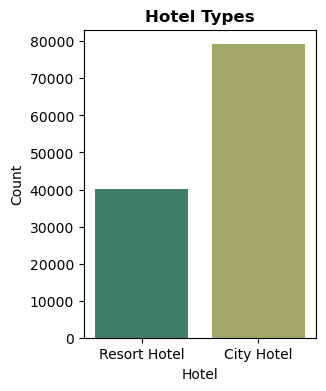

In [20]:
plt.figure(figsize=(3,4))
sns.countplot(x='hotel', data = hotel_df, palette='gist_earth')
plt.title('Hotel Types', weight='bold')
plt.xlabel('Hotel', fontsize=10)
plt.ylabel('Count', fontsize=10)

print("Percentage Booking in Resort Hotel : ",len(hotel_df[hotel_df['hotel']=="Resort Hotel"])/len(hotel_df))
print("Percentage Booking in City Hotel : ",len(hotel_df[hotel_df['hotel']=="City Hotel"])/len(hotel_df))

- According to the graph, City Hotel was booked for more than 66% and rest for the Resort Hotel

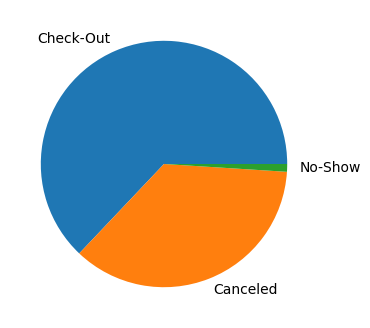

In [21]:
plt.figure(figsize=(4,4))
plt.pie(hotel_df['reservation_status'].value_counts(normalize=True)*100, labels = hotel_df['reservation_status'].unique())
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_6228\2624850203.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = hotel_df.corr(method='pearson')['is_canceled'][:].drop('is_canceled')


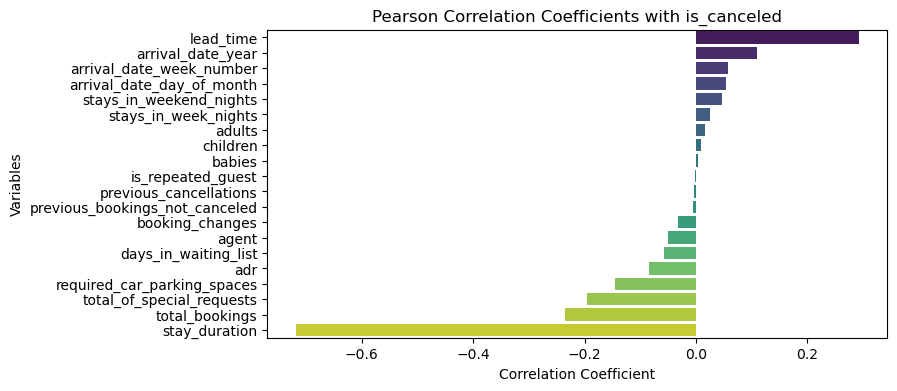

In [22]:
correlation = hotel_df.corr(method='pearson')['is_canceled'][:].drop('is_canceled')

plt.figure(figsize=(8, 4))
sns.barplot(x=correlation.sort_values(ascending=False).values, y=correlation.index, palette='viridis')
plt.title('Pearson Correlation Coefficients with is_canceled')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Variables')
plt.show()

- Highest positive correlations : lead_time followed by previous_cancellations
- Highest negative correlations : total_of_special_requests, required_car_parking_spaces

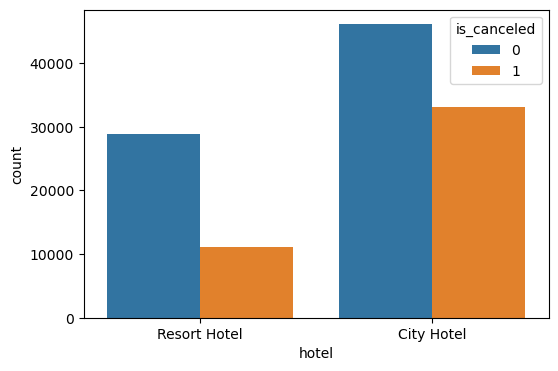

In [23]:
plt.figure(figsize=(6, 4))
sns.countplot(data=hotel_df, x='hotel', hue='is_canceled')
plt.show()

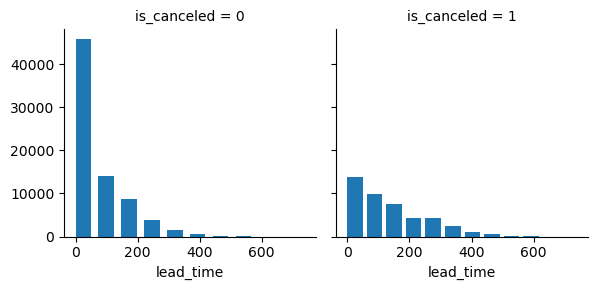

In [24]:
grid = sns.FacetGrid(hotel_df, col='is_canceled')
grid.map(plt.hist, 'lead_time', width=50)
grid.add_legend()

-  Longer the lead_time, lower is the cancelation.

In [25]:
print(len(hotel_df[(hotel_df['stays_in_weekend_nights']==0) & (hotel_df['stays_in_week_nights']==0)])) 

645


- There probably can be an error in the dataset as in real scenario the above is not possible

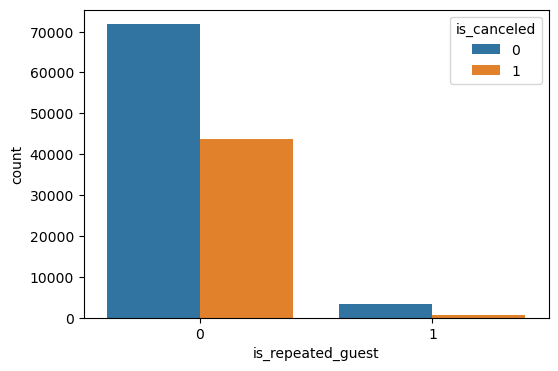

In [26]:
plt.figure(figsize=(6, 4))
sns.countplot(data=hotel_df, x='is_repeated_guest', hue='is_canceled')
plt.show()

- Bookings that are non refundable are canceled.
- Booking with No deposit are much less canceled compared to any other type

<Axes: xlabel='arrival_date_year', ylabel='count'>

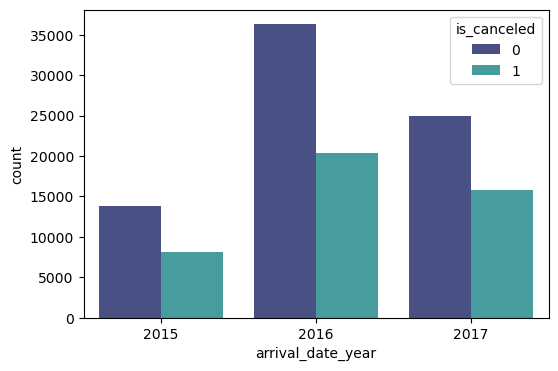

In [27]:
plt.figure(figsize=(6,4))
sns.countplot(data=hotel_df, x='arrival_date_year', hue='is_canceled', palette='mako')

<Figure size 800x300 with 0 Axes>

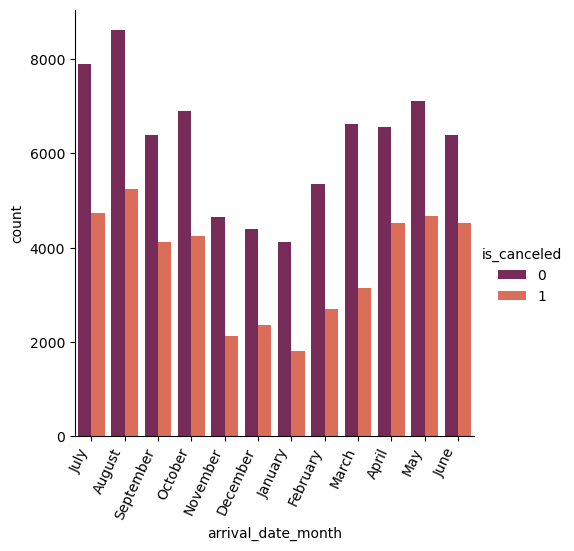

In [28]:
plt.figure(figsize=(8,3))
chart = sns.catplot(data=hotel_df, x='arrival_date_month', hue='is_canceled', kind='count', palette='rocket')
chart.set_xticklabels(rotation=65, horizontalalignment='right')
plt.show()

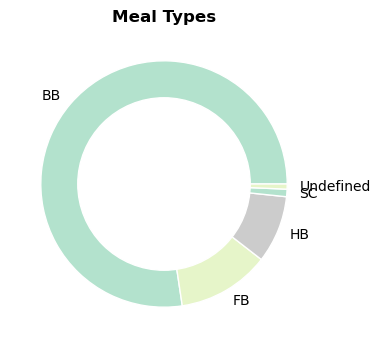

In [29]:
size = hotel_df['meal'].value_counts()
plt.figure(figsize=(4,4))
cmap =plt.get_cmap("Pastel2")
colors = cmap(np.arange(3)*4)
my_circle=plt.Circle( (0,0), 0.7, color='white')
plt.pie(size, labels=hotel_df['meal'].unique(), colors=colors, wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white' })
p=plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Meal Types', weight='bold')
plt.show()

- Most preferred meal is BB

#### *Multivariate Analysis*

c:\Users\HP\anaconda3\Lib\site-packages\seaborn\axisgrid.py:712: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


<Figure size 600x300 with 0 Axes>

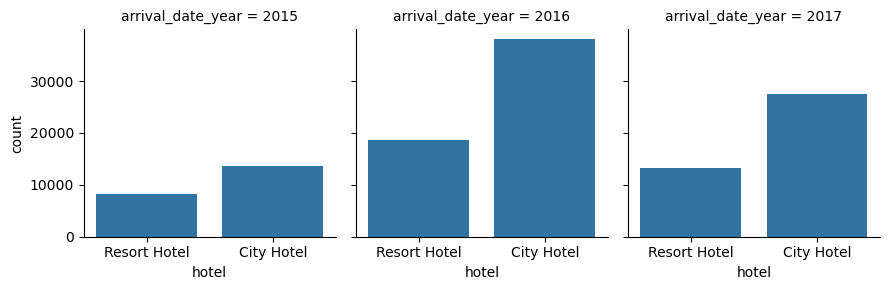

In [30]:
plt.figure(figsize=(6,3))
grid = sns.FacetGrid(hotel_df, col='arrival_date_year')
grid.map(sns.countplot, 'hotel')
plt.show()

- Bookings are more in City Hotel compared to Resort Hotel in all three years

c:\Users\HP\anaconda3\Lib\site-packages\seaborn\axisgrid.py:712: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


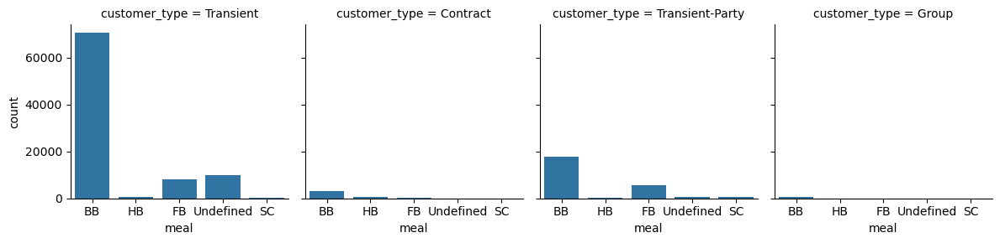

In [31]:
hotel_df['meal'].nunique(), hotel_df['customer_type'].nunique()
grid = sns.FacetGrid(hotel_df, col='customer_type')
grid.map(sns.countplot, 'meal')

- Preferred Meals by all type of customers is BB

In [32]:
hotel_df.pivot_table(columns='hotel', values='country', aggfunc=lambda x:x.mode())

hotel,City Hotel,Resort Hotel
country,PRT,PRT


- Most bookings from the country Portugal with ISO country code PRT for both of the hotels

In [33]:
print(hotel_df.groupby(['customer_type', 'deposit_type']).size())

customer_type    deposit_type
Contract         No Deposit       3526
                 Non Refund        544
                 Refundable          2
Group            No Deposit        566
                 Refundable          8
Transient        No Deposit      76547
                 Non Refund      12909
                 Refundable         20
Transient-Party  No Deposit      23822
                 Non Refund       1134
                 Refundable        132
dtype: int64


In [34]:
print(hotel_df.groupby(['hotel', 'customer_type']).size())

hotel         customer_type  
City Hotel    Contract            2296
              Group                291
              Transient          59272
              Transient-Party    17304
Resort Hotel  Contract            1776
              Group                283
              Transient          30204
              Transient-Party     7784
dtype: int64


In [35]:
hotel_df.pivot_table(columns='hotel', values=['stays_in_weekend_nights', 'stays_in_week_nights'], aggfunc=lambda x:x.sum())

hotel,City Hotel,Resort Hotel
stays_in_week_nights,172640,125289
stays_in_weekend_nights,62865,47649


<Figure size 600x200 with 0 Axes>

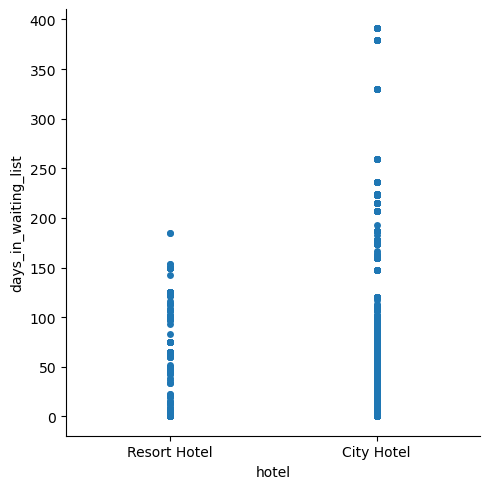

In [36]:
plt.figure(figsize=(6,2))
sns.catplot(data=hotel_df, x='hotel', y='days_in_waiting_list', jitter=False)
plt.show()

Text(0, 0.5, 'Count')

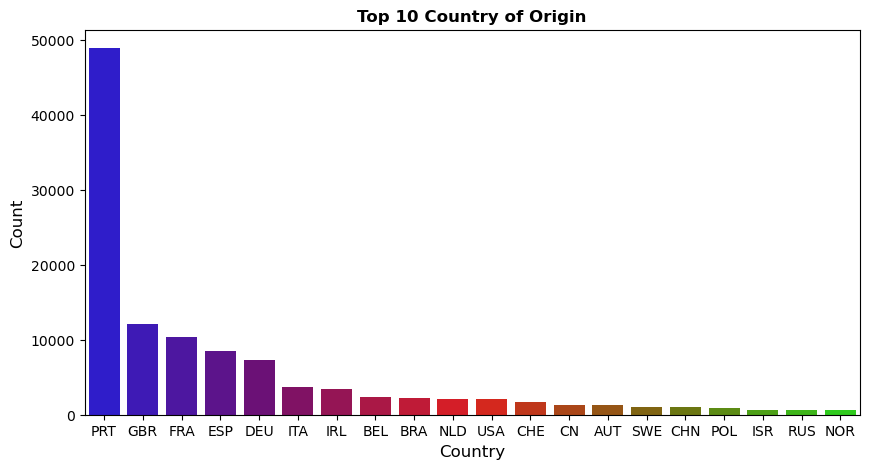

In [37]:

plt.figure(figsize=(10,5))
sns.countplot(x='country', data=hotel_df, 
              order=pd.value_counts(hotel_df['country']).iloc[:20].index, palette="brg")
plt.title('Top 10 Country of Origin', weight='bold')
plt.xlabel('Country', fontsize=12)
plt.ylabel('Count', fontsize=12)

- Approx. 40% of all bookings made in the same location: Portugal.

####  EDA with y-data Profiling
*An alernative method of performing Exploratory Data Analysis with inbuilt libraries*

In [38]:
report = pp.ProfileReport(hotel_df)

In [39]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [132]:
report.to_file("..eda/data_profile_report.html")

c:\Users\HP\anaconda3\Lib\site-packages\ydata_profiling\profile_report.py:354: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Feature Engineering

### Encoding Categorical Data

In [ ]:
month_map = {'January':'01', 'February':'02', 'March':'03', 'April':'04', 'May':'05', 'June':'06', 'July':'07', 'August':'08', 'September':'09', 'October':'10', 'November':'11', 'December':'12'}
hotel_df.arrival_date_month = hotel_df.arrival_date_month.map(month_map).astype(int)

In [41]:
def roomChange(row):
    if row['assigned_room_type'] == row['reserved_room_type']:
        return False
    else:
        return True

hotel_df['change_in_room'] = hotel_df.apply(roomChange, axis=1)

In [42]:
hotel_df['children'] = hotel_df['children'].fillna(0)
hotel_df['children'] = (hotel_df['children'] + hotel_df['babies']).astype(int)

In [43]:
hotel_df['total_bookings'] = hotel_df['previous_cancellations'] + hotel_df['previous_bookings_not_canceled']

In [44]:
hotel_df.loc[hotel_df['country'] == 'PRT', 'country'] = 1
hotel_df.loc[hotel_df['country'] == 'GBR', 'country'] = 2
hotel_df.loc[~((hotel_df['country'] == 'GBR') | (hotel_df['country'] == 'PRT')), 'country'] = 0

In [45]:
#Using LabelEncoder
lb = LabelEncoder()
var = ['hotel', 'customer_type', 'deposit_type', 'change_in_room', 'market_segment', 'distribution_channel']
for item in var:
    hotel_df[item] = lb.fit_transform(hotel_df[item])
hotel_df = pd.get_dummies(hotel_df, columns=['hotel', 'customer_type', 'deposit_type', 'change_in_room', 'market_segment', 'distribution_channel', 'country'])

C:\Users\HP\AppData\Local\Temp\ipykernel_6228\1985217038.py:6: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  hotel_df = pd.get_dummies(hotel_df, columns=['hotel', 'customer_type', 'deposit_type', 'change_in_room', 'market_segment', 'distribution_channel', 'country'])


In [46]:
hotel_df.drop(['meal', 'assigned_room_type', 'reserved_room_type', 'reservation_status', 'reservation_status_date', 'arrival_date'], axis=1, inplace=True)

### Encoding Numerical Data

In [47]:
numerical_columns = ['lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children', 'babies', 'previous_cancellations', 'booking_changes', 'previous_bookings_not_canceled', 'days_in_waiting_list', 'adr', 'required_car_parking_spaces', 'total_of_special_requests']

In [48]:
#Encoding using PowerTransformer
power_transformer = PowerTransformer()
hotel_df[numerical_columns] = power_transformer.fit_transform(hotel_df[numerical_columns])

### Scaling the Numerical Data

In [49]:
scaler = StandardScaler()
hotel_df[numerical_columns] = scaler.fit_transform(hotel_df[numerical_columns])

In [139]:
hotel_df.to_csv('..data/preprocessed_data.csv', index=False)

In [113]:
mm_scaler = MinMaxScaler()
hotel_df_mm = hotel_df
hotel_df_mm = mm_scaler.fit_transform(hotel_df_mm)

## Split the data into Train and Test set

In [51]:
train_var = hotel_df.drop(['is_canceled'], axis=1)
test_var = hotel_df['is_canceled']
X_train, X_test, y_train, y_test = train_test_split(train_var, test_var, test_size=0.20)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

train_var_mm = hotel_df_mm.drop(['is_canceled'], axis=1)
test_var_mm = hotel_df_mm['is_canceled']
X_train_mm, X_test_mm, y_train_mm, y_test_mm = train_test_split(train_var_mm, test_var_mm, test_size=0.20)
X_train_mm.shape, y_train_mm.shape, X_test_mm.shape, y_test_mm.shape

((95368, 46), (95368,), (23842, 46), (23842,))

## Model Creation and Evaluation 

In [52]:
#model evaluation function 
def print_model_evaluation(X_test, y_test, model, y_pred):
    scores = cross_val_score(model, X_train, y_train, cv=5)
    roc_auc = roc_auc_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    print(f"Cross value score : {scores}")
    print("ROC AUC Score: {:.3f}".format(roc_auc))
    print("Average cross validation score: {:.3f}".format(scores.mean()))
    print("Test accuracy: {:.3f}".format(model.score(X_test, y_test)))
    print("F1 score: {:.3f}".format(f1_score(y_test, y_pred)))

    #Visualising the Confusion Model
    print("Confusion Matrix:")
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Not Canceled', 'Canceled'], 
                yticklabels=['Not Canceled', 'Canceled'])
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()

### Initialising and Training different Models

Evaluation of the Ridge Classifier Model with Scaled Data
Cross value score : [0.9726329  0.97310475 0.97341931 0.97331306 0.9726839 ]
ROC AUC Score: 0.963
Average cross validation score: 0.973
Test accuracy: 0.973
F1 score: 0.962
Confusion Matrix:


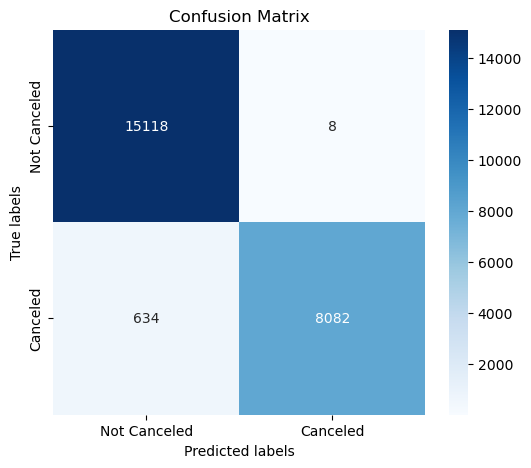

In [116]:
#Ridge Classifier
rc = RidgeClassifier(alpha=1)
rc.fit(X_train, y_train)
rc_pred = rc.predict(X_test)

#Evaluating Model Performance
print("Evaluation of the Ridge Classifier Model with Scaled Data")
print_model_evaluation(X_test, y_test, rc, rc_pred)

Evaluation of the Naive Bayes Model
Cross value score : [0.96413967 0.95984062 0.96261927 0.96314161 0.95952393]
ROC AUC Score: 0.948
Average cross validation score: 0.962
Test accuracy: 0.962
F1 score: 0.945
Confusion Matrix:


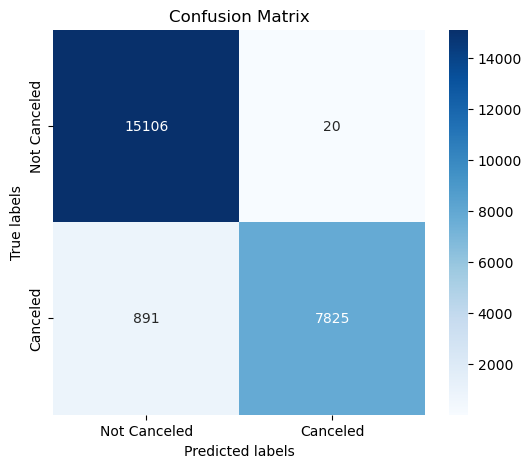

In [126]:
#Naive Bayes
gnb = GaussianNB()
gnb.fit(X_train, y_train) #Fitting the training data
gnb_pred = gnb.predict(X_test) #Predicting the data

#Evaluating Model Performance
print("Evaluation of the Naive Bayes Model")
print_model_evaluation(X_test, y_test, gnb, gnb_pred)

Evaluation of the knn Model
Accuracy score : 0.984103682576965
ROC AUC Score: 0.981
Test accuracy: 0.984
F1 score: 0.978
Confusion Matrix:


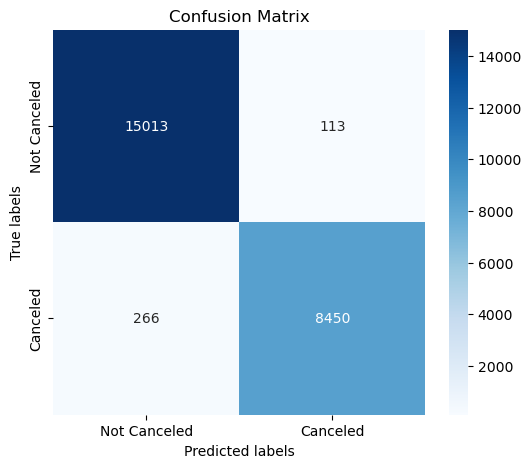

In [107]:
#KNN
X_train_array = X_train.values
y_train_array = y_train.values
X_test_array = X_test.values
y_test_array = y_test.values


knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train_array, y_train_array)
knn_pred = knn.predict(X_test_array)

print("Evaluation of the knn Model")
accuracy = accuracy_score(y_test_array, knn_pred)
roc_auc = roc_auc_score(y_test_array, knn_pred)
cm = confusion_matrix(y_test_array, knn_pred)
print(f"Accuracy score : {accuracy}")
print("ROC AUC Score: {:.3f}".format(roc_auc))
print("Test accuracy: {:.3f}".format(knn.score(X_test_array, y_test_array)))
print("F1 score: {:.3f}".format(f1_score(y_test_array, knn_pred)))

#Visualising the Confusion Model
print("Confusion Matrix:")
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Not Canceled', 'Canceled'], 
            yticklabels=['Not Canceled', 'Canceled'])
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

Evaluation of the Decision Tree Model
Cross value score : [0.99549124 0.99491454 0.9950194  0.9945997  0.99454727]
ROC AUC Score: 0.995
Average cross validation score: 0.995
Test accuracy: 0.993
F1 score: 0.991
Confusion Matrix:


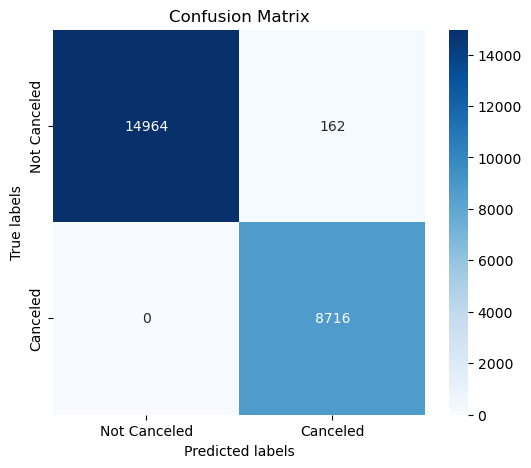

In [128]:
#Decision Tree
tree = DecisionTreeClassifier(max_depth=1).fit(X_train, y_train)
scores = cross_val_score(tree, X_train, y_train, cv=5)
tree_pred = tree.predict(X_test)

print("Evaluation of the Decision Tree Model")
print_model_evaluation(X_test, y_test, tree, tree_pred)

In [111]:

def classifier(train, test, estimator, param_grid):
    grid_search = GridSearchCV(estimator, param_grid, cv=5)
    grid_search.fit(train, y_train)
    print("Best parameters:", grid_search.best_params_)
    print("Best score:", grid_search.best_score_)
    print("Test score: {:.3f}".format(grid_search.score(test, y_test)))

def feature_selection(model):
    select_features = SelectFromModel(estimator=model, threshold='median')
    select_features.fit(X_train, y_train)
    X_train_select = select_features.transform(X_train)
    X_test_select = select_features.transform(X_test)
    return X_train_select, X_test_select

def run_model(model, model_feature, param_grid):
    print("Before feature selection:")
    classifier(X_train, X_test, model, param_grid)
    X_train_select, X_test_select = feature_selection(model_feature)
    print("After feature selection")
    classifier(X_train_select, X_test_select, model, param_grid)

In [129]:
#Random Forest
param_grid = {'n_estimators':[50,75,100], 'max_depth':[1,2,5]}
run_model(RandomForestClassifier(), RandomForestClassifier(n_estimators=50, max_depth=2), param_grid)

Before feature selection:
Best parameters: {'max_depth': 5, 'n_estimators': 100}
Best score: 0.9977875097978028
Test score: 0.997
After feature selection
Best parameters: {'max_depth': 5, 'n_estimators': 100}
Best score: 0.9985634681265039
Test score: 0.999


In [112]:
#Gradient Boosted Classifier
param_grid = {'max_depth':[1,2,5], 'learning_rate':[1,0.1,0.001]}
run_model(GradientBoostingClassifier(), GradientBoostingClassifier(learning_rate=0.001), param_grid)

Before feature selection:
Best parameters: {'learning_rate': 0.1, 'max_depth': 5}
Best score: 0.9996015419550964
Test score: 0.999
After feature selection
Best parameters: {'learning_rate': 0.1, 'max_depth': 5}
Best score: 0.9996120279824648
Test score: 0.999


Evaluation of the Multi Layer Perceptron Model
Cross value score : [0.99103492 0.99543882 0.9961728  0.99832224 0.99507157]
ROC AUC Score: 0.997
Average cross validation score: 0.995
Test accuracy: 0.996
F1 score: 0.994
Confusion Matrix:


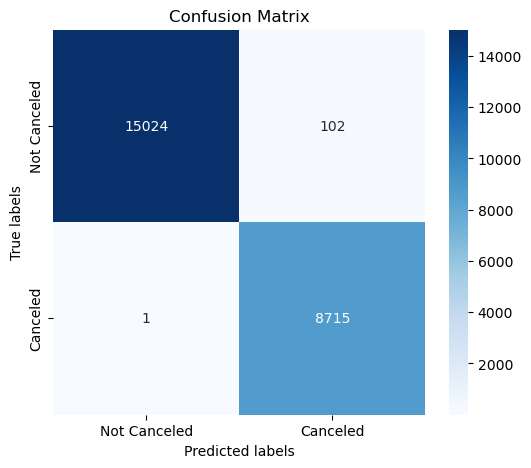

In [109]:
#Multi Layer Perceptron
mlp = MLPClassifier(hidden_layer_sizes=[35, 20], alpha=0.001, solver='adam', activation='relu')
mlp.fit(X_train, y_train)
mlp_pred = mlp.predict(X_test)

#Evaluating Model Performance
print("Evaluation of the Multi Layer Perceptron Model")
print_model_evaluation(X_test, y_test, mlp, mlp_pred)

Evaluation of the Adaboost Classifier Model
Cross value score : [0.99952815 0.99947573 0.99958058 0.99973785 0.9994757 ]
ROC AUC Score: 0.999
Average cross validation score: 1.000
Test accuracy: 0.999
F1 score: 0.999
Confusion Matrix:


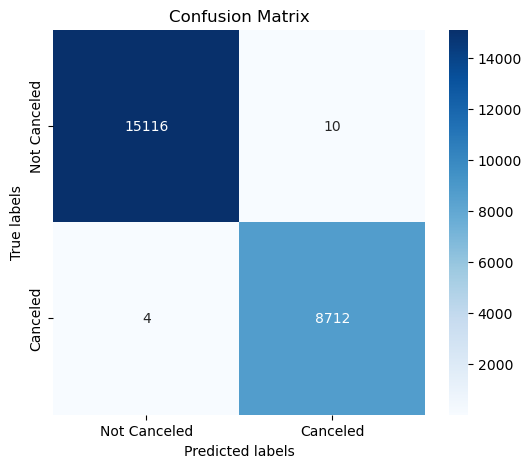

In [110]:
#Adaboost Classifier
ada = AdaBoostClassifier()
ada.fit(X_train, y_train)
ada_pred = ada.predict(X_test)

#Evaluating Model Performance
print("Evaluation of the Adaboost Classifier Model")
print_model_evaluation(X_test, y_test, ada, ada_pred)

## Dump the Models Created

In [130]:
joblib.dump(rc, '..models/ridge_classifier_model.pkl')
joblib.dump(gnb, '..models/naive_bayes_classifier_model.pkl')
joblib.dump(knn, '..models/k_neightbours_classifier_model.pkl')
joblib.dump(tree, '..models/decsion_tree_classifier_model.pkl')
joblib.dump(mlp, '..models/multi_layer_perceptron_model.pkl')
joblib.dump(ada, '..models/ada_boost_classifier_model.pkl')
joblib.dump(RandomForestClassifier(n_estimators=75, max_depth=5), '..models/ridge_forest_classifier_model.pkl')
joblib.dump(GradientBoostingClassifier(learning_rate=0.1, max_depth=5), '..models/gradient_boosting_classifier_model.pkl')

['D:/Projects/basic-ml-projects/hotel-booking-cancellation-prediction-model/models/gradient_boosting_classifier_model.pkl']